# Deep Probabilistic Generative Models - Restricted Boltzmann Machine

A Restricted Boltzmann Machine with Gaussian observed random variables and Bernoulli latent variables. 

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import itertools
import random
import math
import time
import sklearn.datasets

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.autograd as autograd

%matplotlib inline

/home/nilslh/.local/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# samples1-2 shape must be (n samples, 2)
def plot_samples(samples1, samples2=None):
    fig, ax = plt.subplots()

    ax.scatter(samples1[:,0], samples1[:,1], marker="x", color="blue")
    if samples2 is not None:
        ax.scatter(samples2[:,0], samples2[:,1], marker="x", color="red")

## Data generation

The data we will use looks like a ring.
You can see the it would be difficult fit this dataset with a Gaussian Mixture Model: we would need to use many Gaussians and each one would imperfectly fit a subset of the data space.

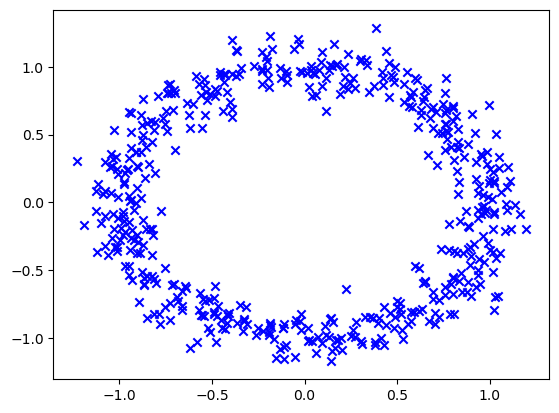

In [3]:
target_samples, y = sklearn.datasets.make_circles(n_samples=1000, noise=0.1, factor=0.2)
target_samples = target_samples[y == 0]
target_samples = torch.from_numpy(target_samples).float()

plot_samples(target_samples)

## Restricted Boltzmann Machine code

The class below represents a restricted Boltzmann Machine.
There are 3 functions you need to code:

- forward: it should return the log-partition of the input, i.e. c(x)
- p_x_given_z: it should return the mean and variance for each observed variable
- p_z_given_x: it should return the bernoulli parameter for each latent variable


In [4]:
class RBM(nn.Module):
    def __init__(self, n_visible = 2, n_hidden=10):
        super().__init__()
        self.n_visible = n_visible
        self.n_hidden = n_hidden
        
        self.b = nn.Parameter(torch.empty(n_visible))
        # because sigma squared should be greater than zero (variance),
        # we instead take parameter log_sigma_squared which is unconstrained.
        self.log_sigma_squared = nn.Parameter(torch.empty(n_visible))
        
        self.W = nn.Parameter(torch.empty(n_visible, n_hidden))
        self.d = nn.Parameter(torch.empty(n_hidden))
        
        self.init_params()
    
    # Initialize parameters:
    # the RBM training loop we are going to code is sensitve to initialization...
    def init_params(self):
        with torch.no_grad():
            self.b.fill_(0.)
            self.log_sigma_squared.fill_(math.log(0.1**2))
            self.W.normal_(0., 0.01)
            self.d.normal_(0., 0.1)

    # returns the log-partition function with fixed x, i.e. c(x)
    # - shape of input x: (batch size, n_visible)
    # - shape of return tensor: (batch size,)
    def forward(self, x):
        
        sigma_squared = self.log_sigma_squared.exp()
        
        # left term of log_partition 
        temp1 = torch.sum( torch.div((x - self.b.T) ** 2, 2 * sigma_squared.T), dim=1 )

        # right term of log_part
        temp2 = F.softplus( self.d.T + (torch.div(x, sigma_squared.T) @ self.W) )
        temp2 = torch.sum(temp2, dim=1)
        
        # full log_partition
        c_x = temp1 - temp2
        
        return c_x
        
        
        
    # compute the parameters of the conditional distribution p(x | z)
    # - shape of input z: (batch size, n hidden)
    # - shapes of the two returned tensors:
    #   1. mean of the Gaussians mu: (batch size, n_visible)
    #   2. variance of the Gaussians sigma: (batch size, n_visible)
    def p_x_given_z(self, z):
        sigma_squared = self.log_sigma_squared.exp()
        
        mu = self.b.T + (z @ self.W.T)
        
        # note the variance is independent of the hidden variable,
        # it is fixed, so we just "extend" the dimension of the vector
        # to fit the output shape
        return mu, sigma_squared.unsqueeze(0).repeat(z.shape[0], 1)
    
    # compute the parameters of the Bernoulli conditional distribution p(z | x)
    # - shape of input x: (batch size, n visible)
    # - output shape: (batch size, n hidden)
    def p_z_given_x(self, x):
        sigma_squared = self.log_sigma_squared.exp()
        temp1 =  self.d.T + (torch.div(x, sigma_squared.T) @ self.W)
        params = torch.sigmoid(temp1) 
        return params
        
        

In [5]:
# check shapes of your RBM!
batch_size = 15

machine = RBM()

x = torch.ones((batch_size, machine.n_visible))
f = machine(x)

if f.shape != (batch_size,):
    print("Expected shape: ", (batch_size,))
    print("Returned shape: ", f.shape)
    raise RuntimeWarning("The shape of the log-partition tensor is wrong!")


z = torch.ones((batch_size, machine.n_hidden))
mu, sigma_squared = machine.p_x_given_z(z)

if mu.shape != (batch_size, machine.n_visible):
    print("Expected shape: ", (batch_size, machine.n_visible))
    print("Returned shape: ", mu.shape)
    raise RuntimeWarning("The shape of the Gaussian mean tensor is wrong!")

if sigma_squared.shape != (batch_size, machine.n_visible):
    print("Expected shape: ", (batch_size, machine.n_visible))
    print("Returned shape: ", sigma_squared.shape)
    raise RuntimeWarning("The shape of the Gaussian variance tensor is wrong!")


mu = machine.p_z_given_x(x)
if mu.shape != (batch_size, machine.n_hidden):
    print("Expected shape: ", (batch_size, machine.n_hidden))
    print("Returned shape: ", mu.shape)
    raise RuntimeWarning("The shape of the Bernoulli parameter tensor is wrong!")


/tmp/ipykernel_9542/4233903620.py:34: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matricesor `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2981.)
  temp1 = torch.sum( torch.div((x - self.b.T) ** 2, 2 * sigma_squared.T), dim=1 )


## Training loop

During training, we must approximate the loss via Markov Chain Monte Carlo.
It usual to rely on contrastive divergence in the case of RBM training:

- we use a single sample per batch data point in the Monte Carlo approximation of the partition function contribution to the loss
- we start one Markov Chain per data point in the batch
- we only do a few steps, e.g. in general one!
- we take the last sample from each chain

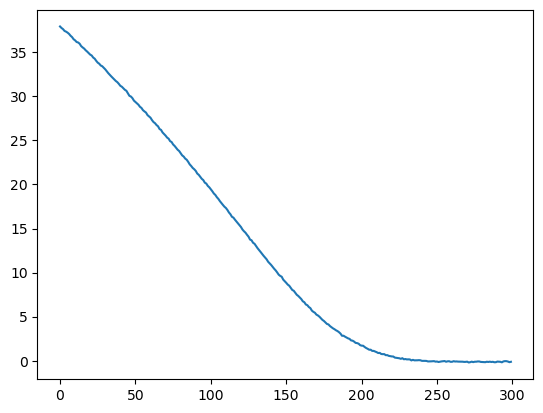

In [6]:
batch_size = target_samples.shape[0] # we just feed all data at once, you can try with smaller batch size
n_epoch = 300 # number of epochs
k = 15 # number of step to take in the Gibbs sampler for contrastive loss

n_visible = target_samples.shape[1]
n_hidden = 100


machine = RBM(n_visible, n_hidden)
# we fix the variance of the observed variables,
machine.log_sigma_squared.requires_grad_(False)
# optimizer
optimizer = torch.optim.SGD(machine.parameters(), lr=1e-3)


losses = list()
for _ in range(n_epoch):
    for i in range(0, target_samples.shape[0], batch_size):
        optimizer.zero_grad()
        data_samples = target_samples[i:i+batch_size]

        with torch.no_grad():
            # generate sample from your model!
            # and store the in a variable called model_samples
            j = 0
            mc_samples = data_samples
            while j < k:
                z = torch.bernoulli(machine.p_z_given_x(mc_samples))
                mu, sigma_squared = machine.p_x_given_z(z)
                mc_samples = torch.normal(mu, sigma_squared.sqrt())
                j = j+1
                
        # the loss function is quite simple
        loss = (machine(data_samples) - machine(mc_samples)).mean()
        losses.append(loss.item())

        loss.backward()
        # we use gradient clipping to stabilize training
        torch.nn.utils.clip_grad_norm_(machine.parameters(), 1)
        optimizer.step()
    
# plot the training loss
plt.plot(np.arange(len(losses)), losses)
plt.show()

## Sampling from the trained RBM

We now turn to sampling from our trained model to check if it models the data correctly.
We will run many markov chains in parallel and do several visualization.
In the first one, we will just plot the samples at the timestep of each markov chain.

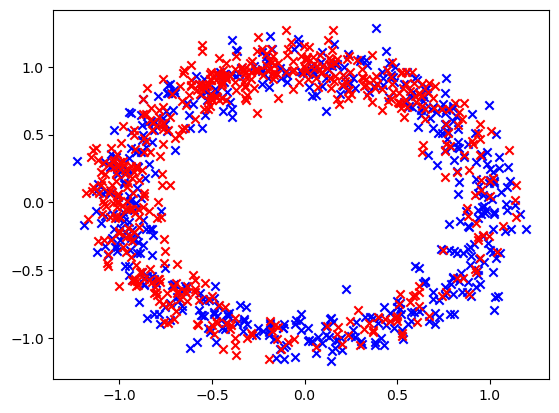

In [12]:
# Sample from the distribution!

n_chains = 500
n_steps = 1000
with torch.no_grad():
    x = torch.empty(n_steps, n_chains, machine.n_visible)
    z = torch.bernoulli(torch.empty(n_chains, machine.n_hidden).fill_(0.5))
    for timestep in range(n_steps):
        mu, sigma_squared = machine.p_x_given_z(z)
        gibbs = torch.normal(mu, sigma_squared.sqrt())
        x[timestep] = gibbs
        z = machine.p_z_given_x(gibbs)

# plot the samples at the last timestep of each markov chaine
plot_samples(target_samples, x[-1])

## Visualization of the Gibbs sampling Markov Chain Monter Carlo sampling process

We can visualization the sampling process in two different ways:

- first, we can plot at the sample of each markov chain at each time step
- second, we focus on a single markov chain and observe how it evolves

Note that we use the values x of before for the animation

In [13]:
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
from matplotlib import animation, rc
from IPython.display import HTML


def animate_mc(animation_data):
    fig, ax = plt.subplots()

    ax.set_xlim(( -1.5, 1.5))
    ax.set_ylim((-1.5, 1.5))

    sct = ax.scatter([], [], lw=2)

    def init():
        sct.set_offsets([])
        return (sct,)

    def animate(i):

        data = animation_data[i]
        
        sct.set_offsets(data)
        
        return sct,
    
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=len(animation_data), interval=20, blit=True)

    return anim.to_jshtml()

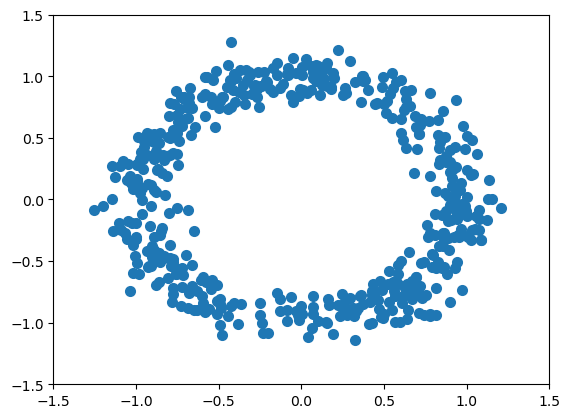

In [14]:

HTML(animate_mc(x[:100].numpy()))

In [16]:
def animate_mc_persitent(animation_data):
    fig, ax = plt.subplots()

    ax.set_xlim(( -1.5, 1.5))
    ax.set_ylim((-1.5, 1.5))

    sct = ax.scatter([], [], lw=2)
    def init():
        sct.set_offsets([])
        return (sct,)

    def animate(i):


        data = animation_data[:i]
        
        sct.set_offsets(data)
        
        return sct,
    
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=len(animation_data), interval=20, blit=True)

    return anim.to_jshtml()

Animation size has reached 21006084 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


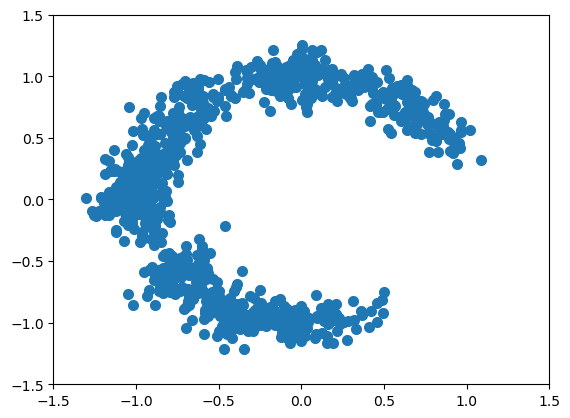

In [19]:

HTML(animate_mc_persitent(x[:n_steps/2,0].numpy()))